In [2]:
# All pacakages needed
import wikipediaapi
import pandas as pd
import re
import numpy as np
import nltk
import matplotlib.pyplot as plt

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from wordcloud import WordCloud, STOPWORDS
import math

In [5]:
path_to_files_small = '../ml-latest-small'
path_to_files_large = './ml-latest'

In [6]:
movie_data_large = pd.read_csv(path_to_files_large + '/movies.csv')
movie_data_large.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [8]:
plot_data = pd.read_csv('./wiki_movie_plots_deduped.csv')
plot_data.head()

,Release Year,Title,Origin/Ethnicity,Director,Cast,Genre,Wiki Page,Plot
0,1901,Kansas Saloon Smashers,American,Unknown,NaN,unknown,https://en.wikipedia.org/wiki/Kansas_Saloon_Sm...,"A bartender is working at a saloon, serving dr..."
1,1901,Love by the Light of the Moon,American,Unknown,NaN,unknown,https://en.wikipedia.org/wiki/Love_by_the_Ligh...,"The moon, painted with a smiling face hangs ov..."
2,1901,The Martyred Presidents,American,Unknown,NaN,unknown,https://en.wikipedia.org/wiki/The_Martyred_Pre...,"The film, just over a minute long, is composed..."
3,1901,"Terrible Teddy, the Grizzly King",American,Unknown,NaN,unknown,"https://en.wikipedia.org/wiki/Terrible_Teddy,_...",Lasting just 61 seconds and consisting of two ...
4,1902,Jack and the Beanstalk,American,"George S. Fleming, Edwin S. Porter",NaN,unknown,https://en.wikipedia.org/wiki/Jack_and_the_Bea...,The earliest known adaptation of the classic f...


In [9]:
# Method for preprocessing the movie data
def data_processing(data_frame, data_frame_new):
    
    # Find the year for each movietitle and add this as a column in the data
    pattern = re.compile(r'(\d\d\d\d)')
    year = data_frame.iloc[:,1].str.extract(pattern, expand=True)
    header = ['movieId', 'title', 'year', 'genres']

    # Find the titles without the year 
    titles = []
    for title in data_frame['title']:
        match = re.search(r'[\w .-:,\'?]+\w+[(\D)]',title)
        if match:
            new_title = match.group().strip()
            # Preproces the titles so the titles is written correct
            if new_title.endswith(', The'):
                new_title = 'The ' + new_title.split(',')[0]
            elif new_title.endswith(', A'):
                new_title = 'A ' + new_title.split(',')[0]
            elif new_title.endswith(', An'):
                new_title = 'An ' + new_title.split(',')[0]
            titles.append(new_title)
    titles = pd.DataFrame(titles)

    # Add the found columns and the existing columns to a new dataframe
    data_frame_new = pd.concat([data_frame['movieId'], titles, year, data_frame['genres']], axis=1)
    data_frame_new.columns = header
    data_frame_new = data_frame_new.dropna().reset_index().drop(columns='index')
    
    return data_frame_new

In [17]:
movie_data_large_new = pd.DataFrame()
movie_data_large_new = data_processing(movie_data_large, movie_data_large_new)
movie_data_large_new.head()

,movieId,title,year,genres
0,1,Toy Story,1995,Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji,1995,Adventure|Children|Fantasy
2,3,Grumpier Old Men,1995,Comedy|Romance
3,4,Waiting to Exhale,1995,Comedy|Drama|Romance
4,5,Father of the Bride Part II,1995,Comedy


In [13]:
tag_data_large = pd.read_csv(path_to_files_large + '/tags.csv')
tag_data_large.head()

,userId,movieId,tag,timestamp
0,14,110,epic,1443148538
1,14,110,Medieval,1443148532
2,14,260,sci-fi,1442169410
3,14,260,space action,1442169421
4,14,318,imdb top 250,1442615195


In [ ]:
plot_data = pd.concat([plot_data['Release Year'].astype(str), plot_data['Title'], plot_data['Plot']], axis=1)
plot_data['Release Year'] = plot_data['Release Year'].astype(str)

In [ ]:
all_movies = pd.merge(plot_data, movie_data_large_new, how='inner', left_on=['Title','Release Year'], right_on=['title','year'])
all_movies = pd.concat([all_movies['movieId'], all_movies['title'], all_movies['year'], all_movies['genres'], all_movies['Plot']], axis=1)
all_movies.head()

In [ ]:
all_movies['sentiment'] = all_movies['Plot'].apply(lambda x: pd.Series(find_sentiment(x), index=['sentiment']))

In [ ]:
all_movies

In [10]:
all_movies.to_csv(r'./all_movie_data.csv')

NameError: name 'all_movies' is not defined

In [11]:
all_movie_data = pd.read_csv('./all_movie_data.csv')
all_movie_data.head()

,Unnamed: 0,title,year,genres,Plot,sentiment
0,0,Jack and the Beanstalk,1902,Adventure|Children|Fantasy,The earliest known adaptation of the classic f...,4.989226
1,1,The Great Train Robbery,1903,Crime|Western,The film opens with two bandits breaking into ...,4.946507
2,2,Dream of a Rarebit Fiend,1906,Comedy|Fantasy,The Rarebit Fiend gorges on Welsh rarebit at a...,4.961944
3,3,Frankenstein,1910,Drama|Horror|Sci-Fi,"Described as ""a liberal adaptation of Mrs. She...",5.052111
4,4,The Musketeers of Pig Alley,1912,Crime|Drama,The film is about a poor married couple living...,4.976410


In [ ]:
all_movie_data = pd.concat([movie_data_large_new['movieId'], all_movie_data['title'], all_movie_data['year'], all_movie_data['genres'], all_movies['Plot']], axis=1)

In [14]:
tag_data_large.head()

,userId,movieId,tag,timestamp
0,14,110,epic,1443148538
1,14,110,Medieval,1443148532
2,14,260,sci-fi,1442169410
3,14,260,space action,1442169421
4,14,318,imdb top 250,1442615195


In [16]:
all_tags = pd.merge(all_movie_data, tag_data_large, how='inner', on=['movieId'])
all_tags = pd.concat([all_tags['userId'], all_tags['title'], all_tags['tag'].astype(str)], axis=1)
all_tags['tagSentiment'] = all_tags['tag'].astype(str).apply(lambda x: pd.Series(find_sentiment(x), index=['tagSentiment']))
all_tags.head()

KeyError: 'movieId'

In [ ]:
all_tags = pd.concat([all_tags['userId'], all_tags['title'], all_tags['tag'],all_tags['tagSentiment'].astype(str)], axis=1)

In [ ]:
all_tags.to_csv(r'all_tag_data.csv')

In [20]:
all_tag_data = pd.read_csv('./all_tag_data.csv')
all_tag_data.head()

,Unnamed: 0,title,tag,tagSentiment
0,0,The Great Train Robbery,camera,5.027500
1,1,The Great Train Robbery,dynamite,4.975000
2,2,The Great Train Robbery,key,4.733333
3,3,The Great Train Robbery,outlaw,5.116667
4,4,The Great Train Robbery,pistol,5.183333


In [21]:
# Find all unique genres
full_genre = []

for line in all_movie_data['genres']:
    line = line.split('|')
    for element in line:
        full_genre.append(element)

unique_genres = set(full_genre)

for genre in unique_genres:
    print(genre)

Documentary
Romance
Animation
Horror
Musical
IMAX
Comedy
Drama
Adventure
Sci-Fi
Western
Action
Mystery
Thriller
(no genres listed)
Film-Noir
Children
War
Fantasy
Crime


In [24]:
all_movie_data.head()

,Unnamed: 0,title,year,genres,Plot,sentiment
0,0,Jack and the Beanstalk,1902,Adventure|Children|Fantasy,The earliest known adaptation of the classic f...,4.989226
1,1,The Great Train Robbery,1903,Crime|Western,The film opens with two bandits breaking into ...,4.946507
2,2,Dream of a Rarebit Fiend,1906,Comedy|Fantasy,The Rarebit Fiend gorges on Welsh rarebit at a...,4.961944
3,3,Frankenstein,1910,Drama|Horror|Sci-Fi,"Described as ""a liberal adaptation of Mrs. She...",5.052111
4,4,The Musketeers of Pig Alley,1912,Crime|Drama,The film is about a poor married couple living...,4.976410


In [26]:
genre_map = {}
genre_sentiment_map = {}

for genre in unique_genres:
    genre_map[genre] = []
    genre_sentiment_map[genre] = []
    for i, row in all_movie_data.iterrows():
        genres = row[3]
        title = row[1]
        sentiment = row[5]
        if genre in genres:
            genre_map[genre].append(title)
            genre_sentiment_map[genre].append(sentiment)

In [29]:
tag_map = {}
tag_sentiment_map = {}

for genre in unique_genres:
#for genre in ['(no genres listed)']:
    tag_map[genre] = []
    tag_sentiment_map[genre] = []
    for i, row in all_tag_data.iterrows():
        title = row[1]
        tag = row[2]
        sentiment = row[3]
        if title in genre_map[genre]:
            tag_map[genre].append(str(tag))
            tag_sentiment_map[genre].append(sentiment)

In [146]:
tag_means = {}
tag_std = {}

for genre in unique_genres:
    mean = np.nanmean(tag_sentiment_map[genre])
    std = np.nanstd(tag_sentiment_map[genre])
    tag_means[genre] = mean
    tag_std[genre] = std
    print('The genre ' + genre + ' has the mean: ' + str(mean) + ' and the standard deviation: ' + str(std))

The genre Documentary has the mean: 5.01895806942064 and the standard deviation: 0.14190972406945868
The genre Romance has the mean: 5.0129262874867315 and the standard deviation: 0.14686928862313445
The genre Animation has the mean: 5.0516949694317175 and the standard deviation: 0.1619447742180101
The genre Horror has the mean: 5.011640032757204 and the standard deviation: 0.14600614629715772
The genre Musical has the mean: 5.033370707325261 and the standard deviation: 0.14838912747604835
The genre IMAX has the mean: 5.034761992187698 and the standard deviation: 0.15393356645995482
The genre Comedy has the mean: 5.00762667416074 and the standard deviation: 0.1490037123624269
The genre Drama has the mean: 5.0196487095282984 and the standard deviation: 0.14651300309684262
The genre Adventure has the mean: 5.025275836868874 and the standard deviation: 0.15506161133796018
The genre Sci-Fi has the mean: 5.0410678500141 and the standard deviation: 0.16430441471459659
The genre Western has t

In [31]:
# Convert the map to np array to remove nan's
for genre in unique_genres:
    tag_sentiment_map[genre] = np.array(tag_sentiment_map[genre])
    tag_sentiment_map[genre] = tag_sentiment_map[genre][np.isfinite(tag_sentiment_map[genre])]

In [32]:
tag_sentiment_map['Adventure']

array([4.74461538, 5.10733333, 4.96636364, ..., 5.08571429, 4.98      ,
       4.95      ])

In [ ]:
#_a = np.array(tag_sentiment_map['(no genres listed)'])
#_a = _a[np.isfinite(_a)]


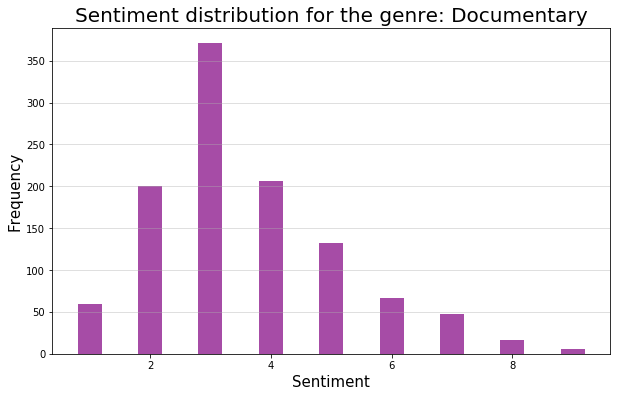

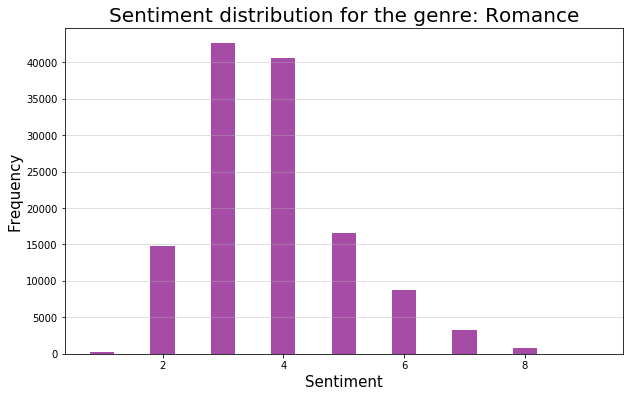

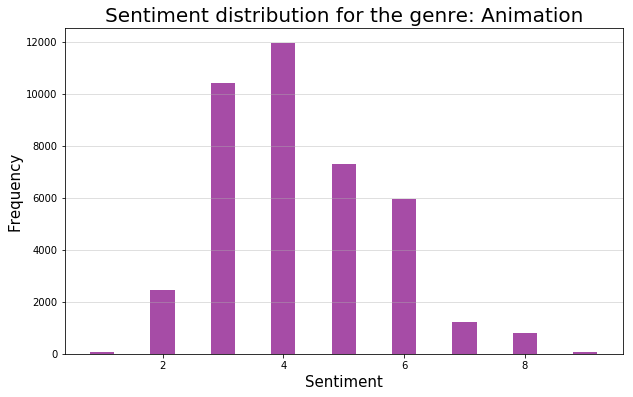

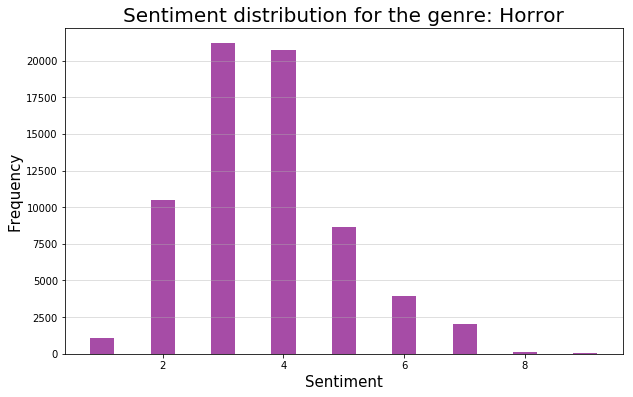

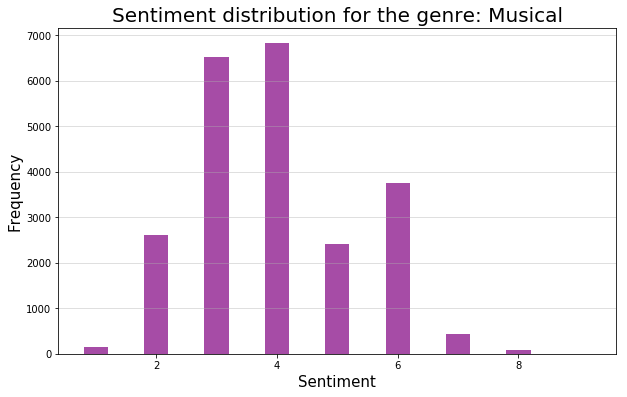

...

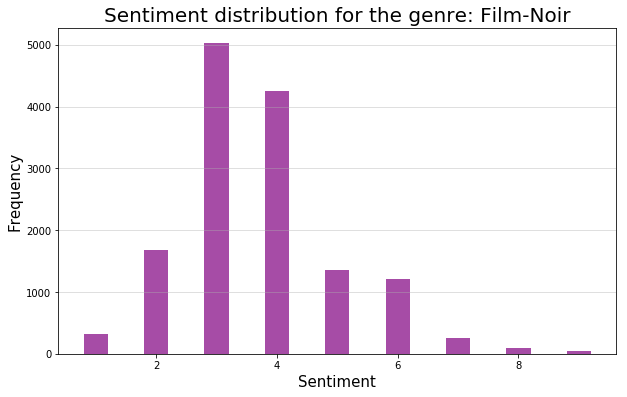

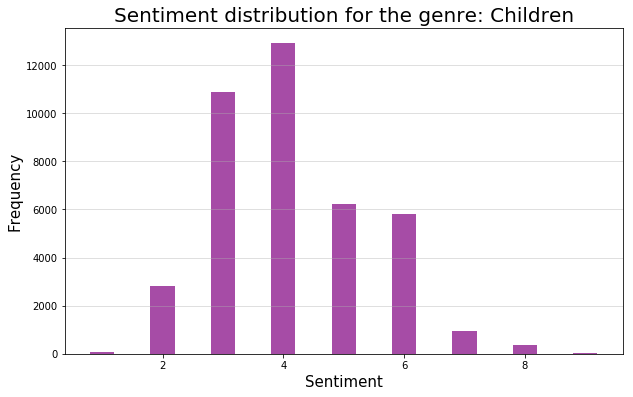

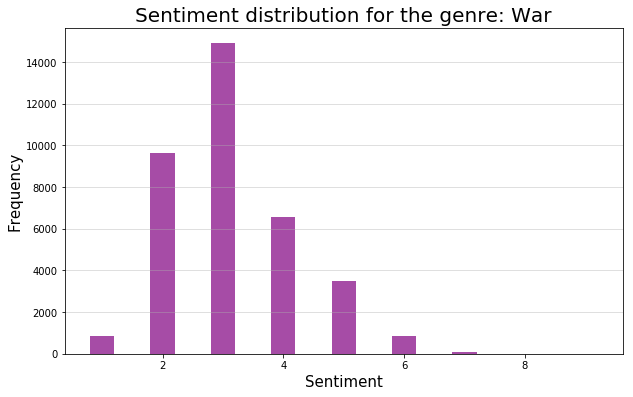

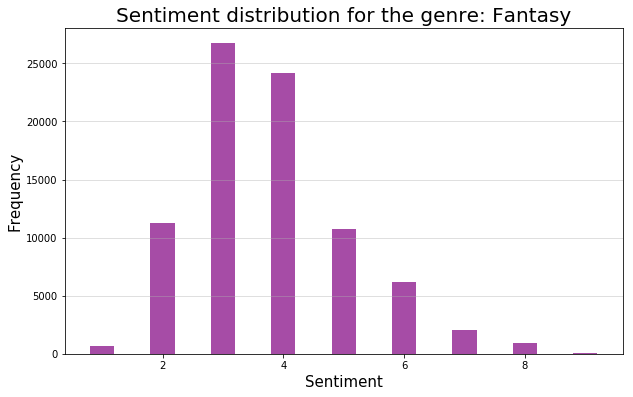

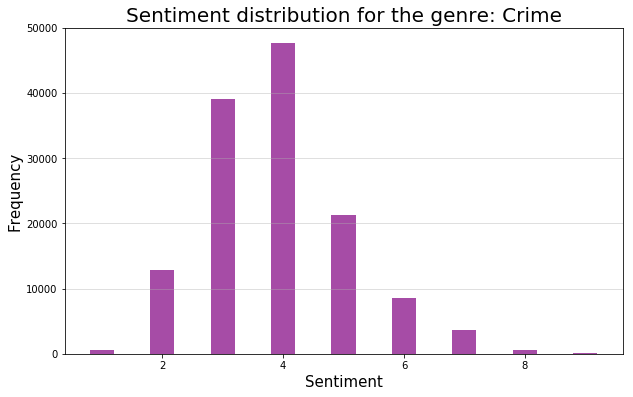

In [33]:
# The x-axis for the histograms
bins_sen = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

for genre in unique_genres:

    # Histogram for the tag sentiment for the unique genres
    hist, bins = np.histogram(tag_sentiment_map[genre],bins=9)

    plt.figure(figsize=(10,6))
    plt.bar(bins_sen, hist, width = 0.4, color='purple',alpha=0.7)
    plt.grid(axis='y', alpha=0.5)
    plt.title('Sentiment distribution for the genre: ' + genre, size=20)
    plt.xlabel('Sentiment',size=15)
    plt.ylabel('Frequency',size=15)
    plt.show()

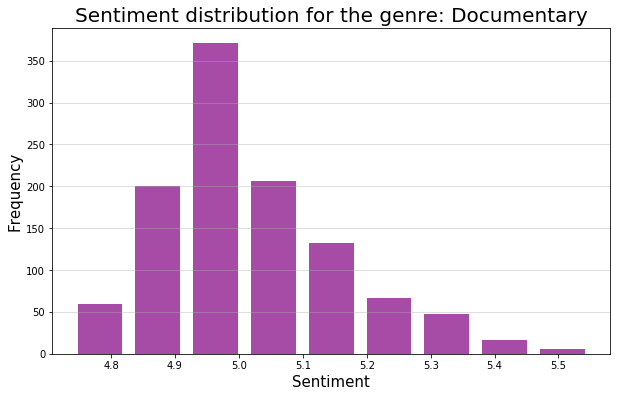

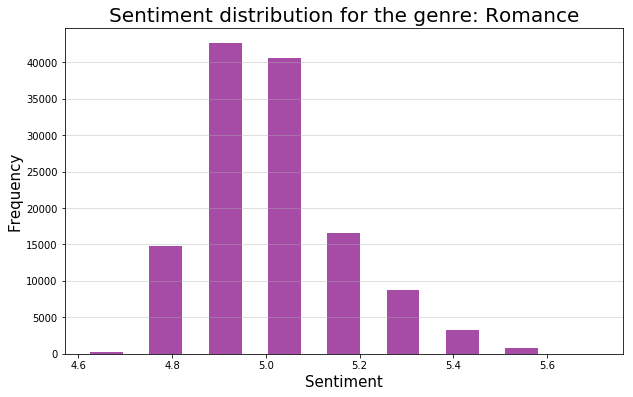

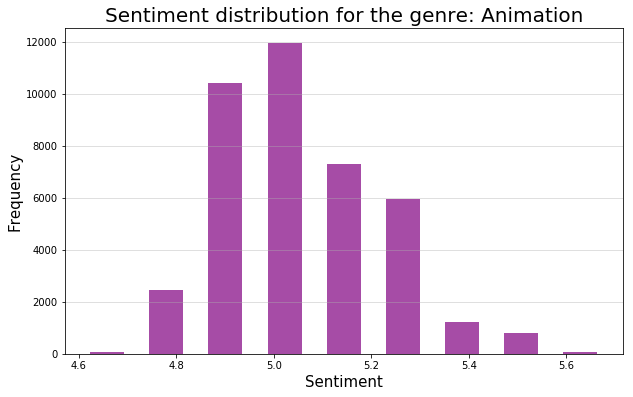

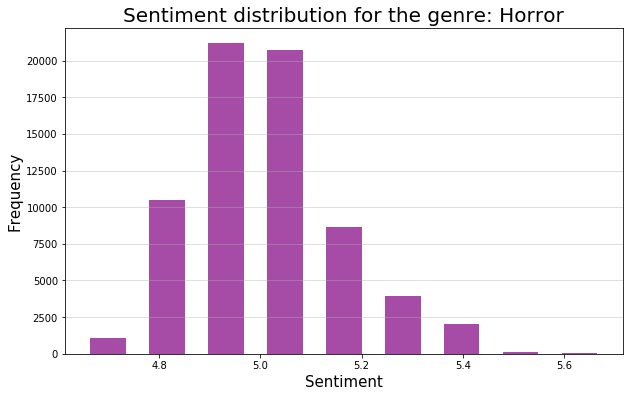

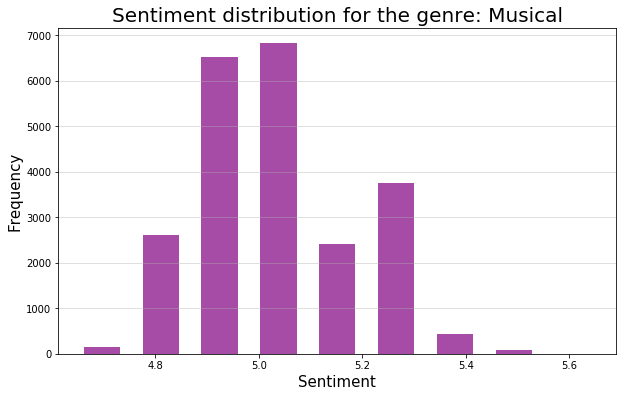

...

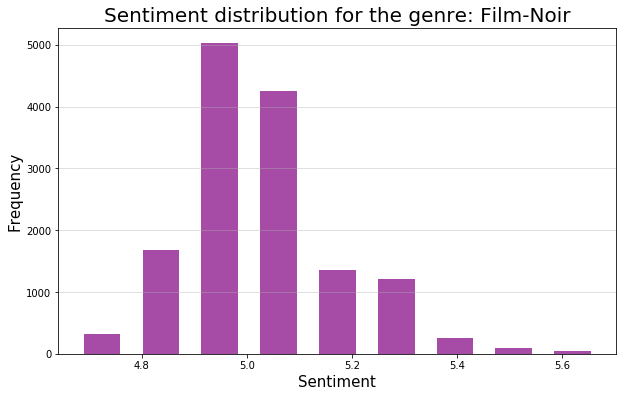

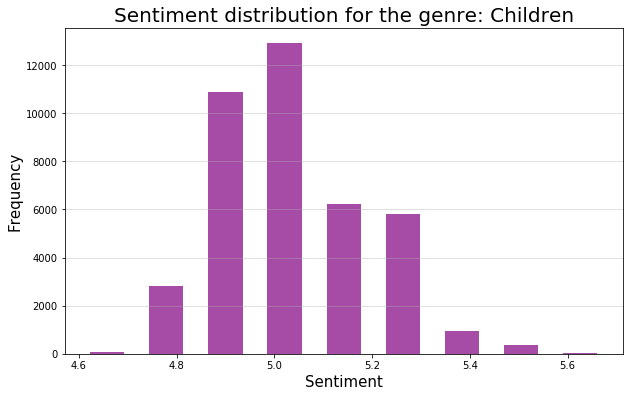

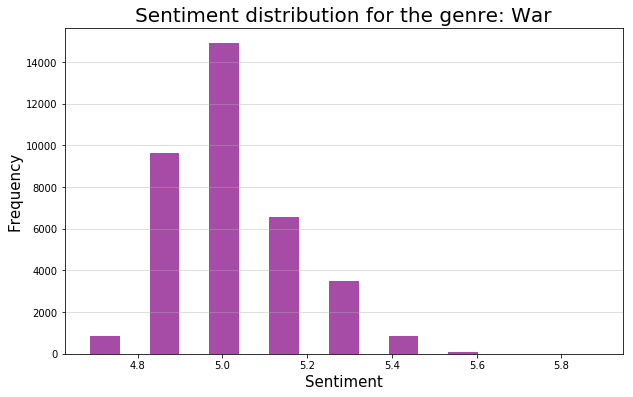

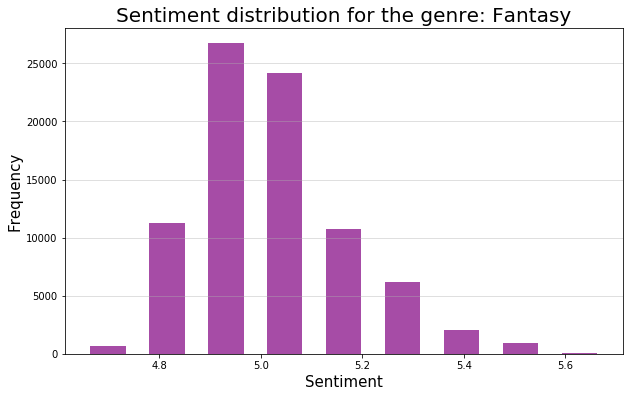

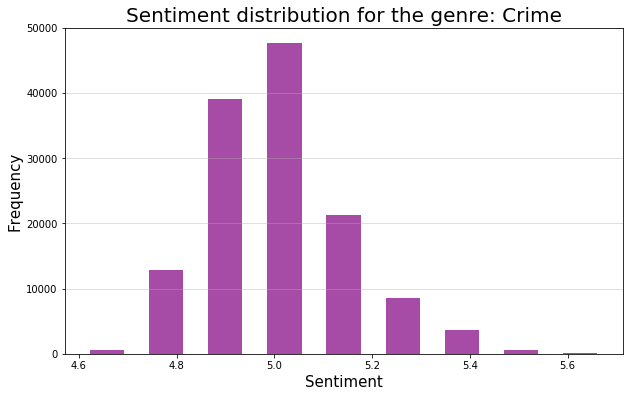

In [151]:
for genre in unique_genres:

    # Get the distribution
    hist, bins = np.histogram(tag_sentiment_map[genre],bins=9)
    # Make correction
    correction = bins[:-1]+(bins[1:]-bins[:-1])*0.5

    plt.figure(figsize=(10,6))
    plt.bar(correction, hist, width = 0.07, color='purple',alpha=0.7)
    plt.grid(axis='y', alpha=0.5)
    plt.title('Sentiment distribution for the genre: ' + genre, size=20)
    plt.xlabel('Sentiment',size=15)
    plt.ylabel('Frequency',size=15)
    plt.show()

In [158]:
# Method to create a wordcloud based on the corpus being a dict
def create_wordcloud(corpus_dict, corpus):
    
    # Initialization
    word_count_vector = {}
    tfidf_values = {}
    sorted_tfidf_values = {}
    keywords = {}
    wc = {}
    
    # Create a word count vector object
    cv = CountVectorizer(max_df=0.90, stop_words = 'english')
    word_count_vector = cv.fit_transform(corpus)
    feature_names = cv.get_feature_names()
    
    # Create TF-IDF transform object
    tfidf_transform = TfidfTransformer(smooth_idf=True, use_idf=True)
    tfidf_transform.fit(word_count_vector)
    
    # Go through each genre to create the wordcloud for each genre
    for genre in unique_genres:
        tfidf_values[genre] = tfidf_transform.transform(cv.transform([corpus_dict[genre]]))
        
        #Sorted TF-IDF values for each of the genres
        sorted_tfidf_values[genre] = sort_coo(tfidf_values[genre].tocoo())
        
        # Get keywords and their corresponding TF-IDF value for the genres
        keywords[genre] = extract_from_vector(feature_names,sorted_tfidf_values[genre])

        # Scale the frequencies (i.e. the TF-IDF values) by a factor 100
        scaled_freq = dict([(key,val*100) for key, val in keywords[genre].items()])

        # Compute string of keywords. Each keyword is multiplied by its 'frequency'
        wc[genre] = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq.items()])
        
    return wc

In [159]:
# create corpus
tag_corpus = []
tag_corpus_dict = {}

for genre in unique_genres:
    genre_list = ' '.join(tag_map[genre])
    tag_corpus.append(genre_list)
    tag_corpus_dict[genre] = genre_list

In [39]:
# Method to extract values from the TF-IDF matrix
def extract_from_vector(feature_names, sorted_items):
    score_vals = []
    feature_vals = []
    
    for idx, score in sorted_items:
        
        score_vals.append(round(score,3))
        feature_vals.append(feature_names[idx])
        
    results = {}
    for idx in range(len(feature_vals)):
        results[feature_vals[idx]] = score_vals[idx]
        
    return results

In [40]:
# Method to sort a sparse matrix
def sort_coo(coo_matrix):
    tuples = zip(coo_matrix.col, coo_matrix.data)
    return sorted(tuples, key = lambda x: (x[1], x[0]), reverse=True)

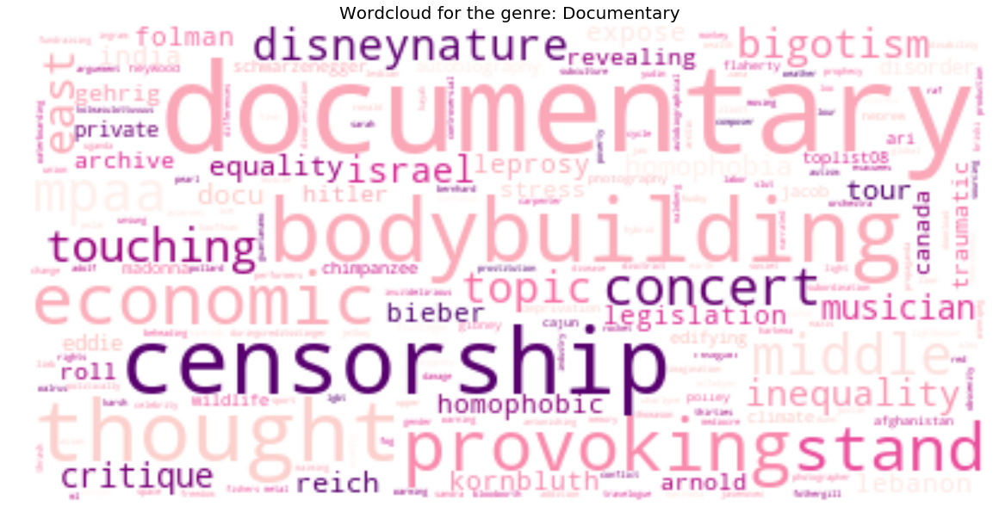

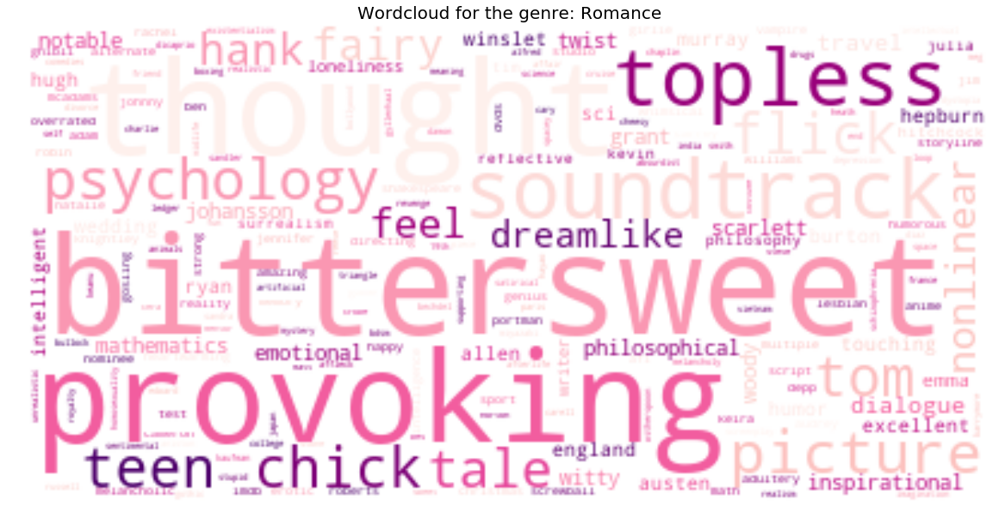

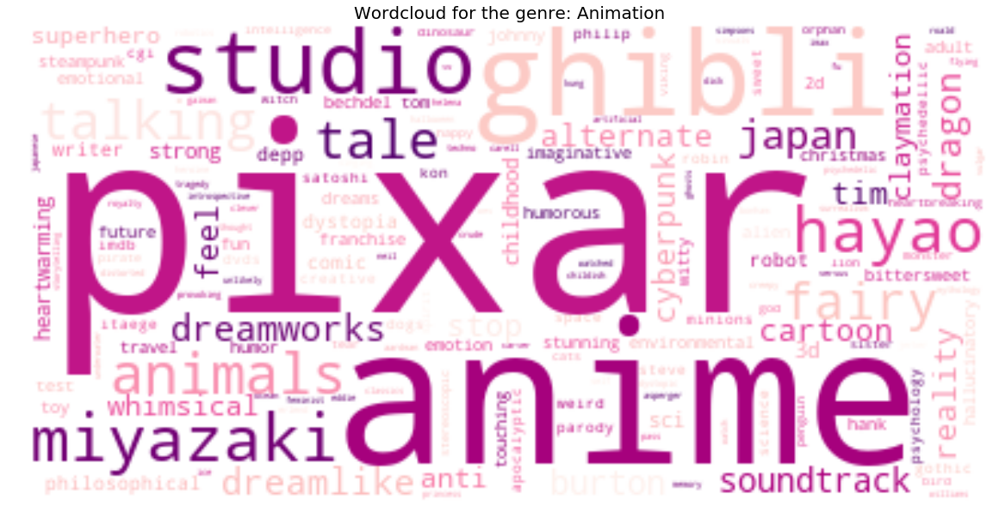

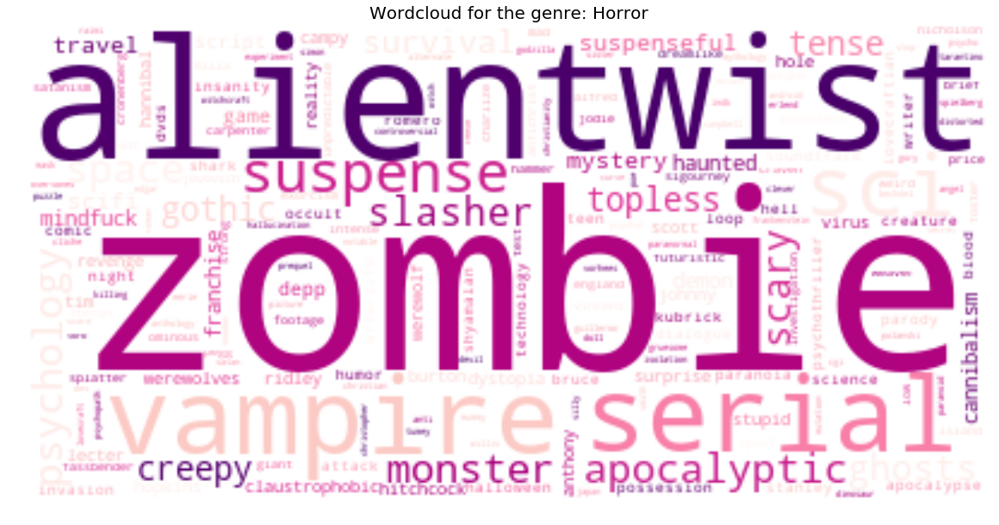

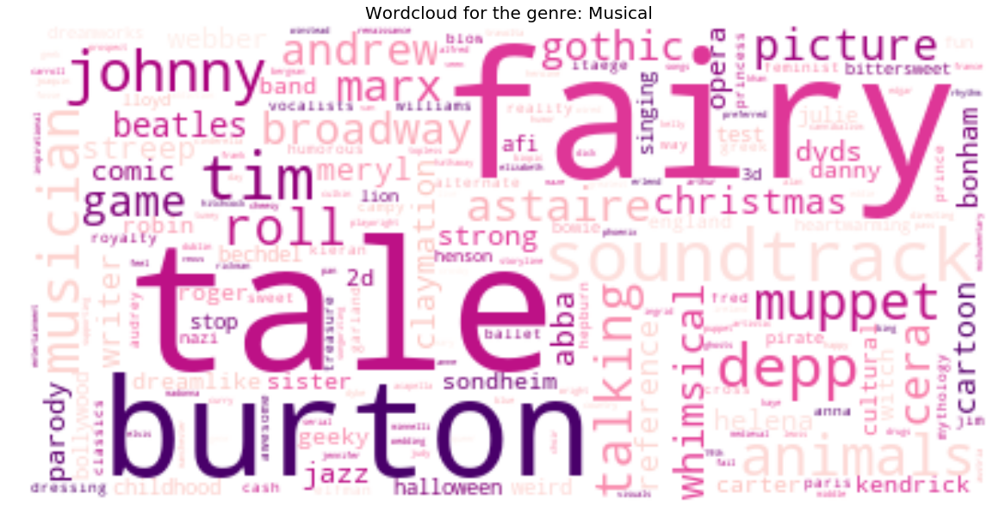

...

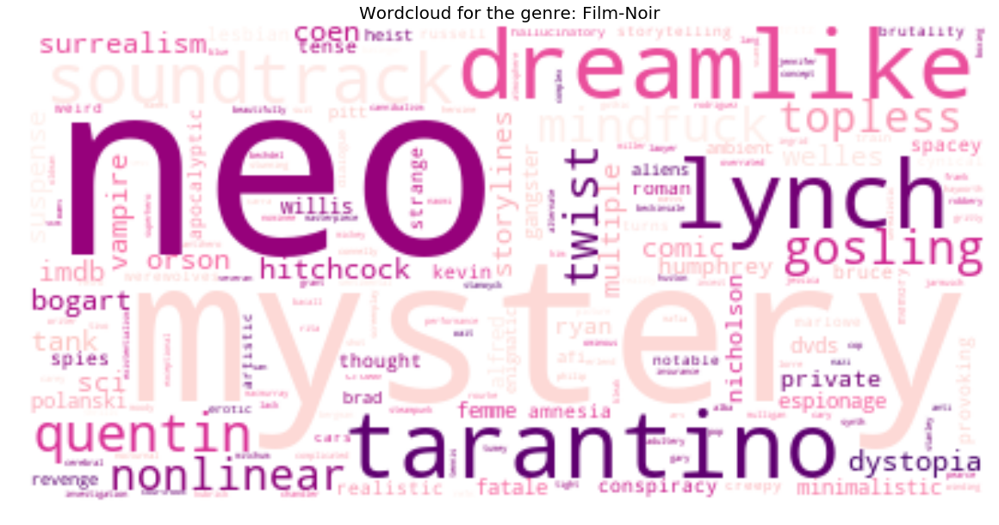

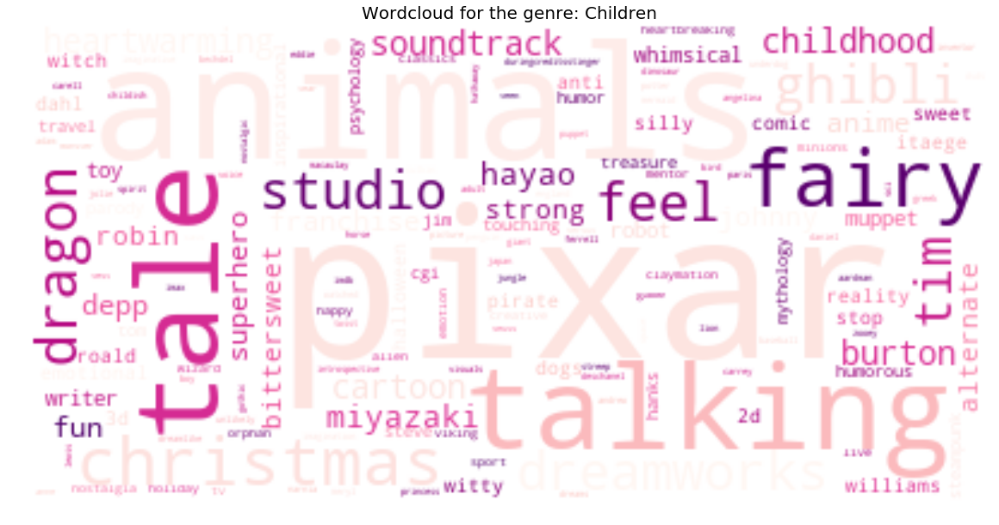

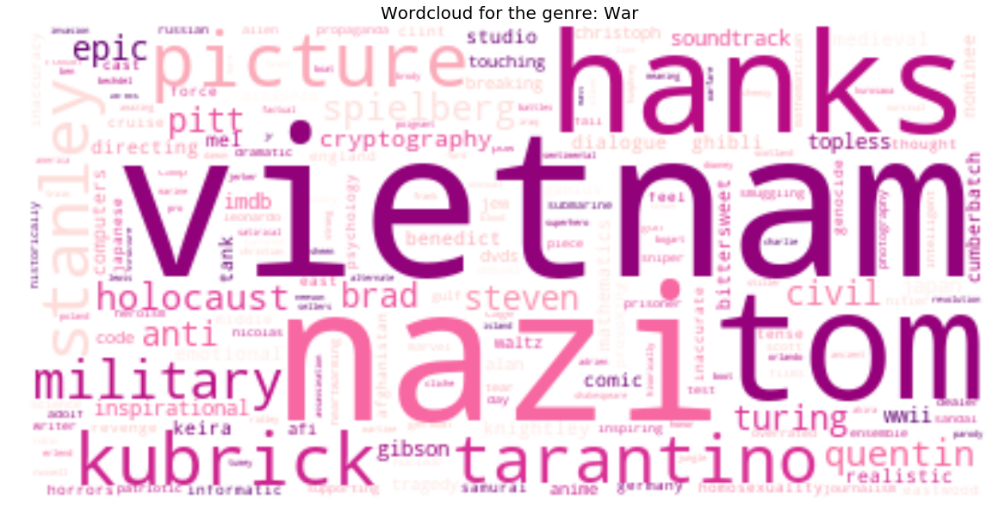

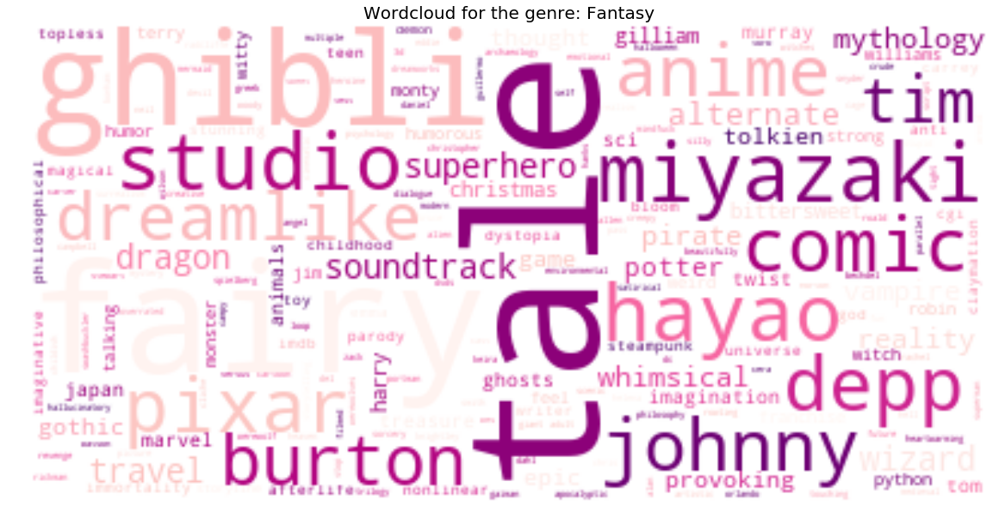

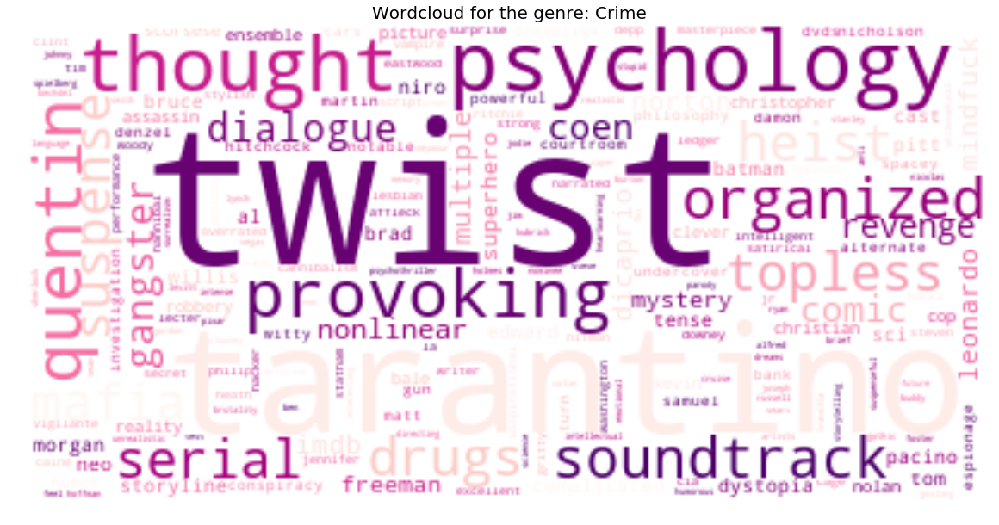

In [160]:
for genre in unique_genres:
    wordcloud = WordCloud(background_color="white", collocations=False,colormap='RdPu').generate(create_wordcloud(tag_corpus_dict, tag_corpus)[genre])

    # Display the generated image:
    plt.figure(1,figsize=[20,20])
    plt.title('Wordcloud for the genre: ' + genre, size = 20)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [49]:
# Create a word count vector object
cv = CountVectorizer(max_df=0.90, stop_words = 'english')
#word_count_vector = {}

word_count_vector = cv.fit_transform(tag_corpus)

In [50]:
# Create TF-IDF transform object
tfidf_transform = TfidfTransformer(smooth_idf=True, use_idf=True)
tfidf_transform.fit(word_count_vector)

TfidfTransformer(norm='l2', smooth_idf=True, sublinear_tf=False, use_idf=True)

In [53]:
'''tfidf_values = {}

#for genre in unique_genres:
    # Get TF-IDF values for the tokens for the genres
    #tfidf_values[genre] = tfidf_transform.transform(cv.transform([tag_corpus[]]))
    
# Get TF-IDF values for the tokens for the genres
tfidf_values0 = tfidf_transform.transform(cv.transform([tag_corpus[0]]))
tfidf_values1 = tfidf_transform.transform(cv.transform([tag_corpus[1]]))
tfidf_values2 = tfidf_transform.transform(cv.transform([tag_corpus[2]]))
tfidf_values3 = tfidf_transform.transform(cv.transform([tag_corpus[3]]))
tfidf_values4 = tfidf_transform.transform(cv.transform([tag_corpus[4]]))
tfidf_values5 = tfidf_transform.transform(cv.transform([tag_corpus[5]]))
tfidf_values6 = tfidf_transform.transform(cv.transform([tag_corpus[6]]))
tfidf_values7 = tfidf_transform.transform(cv.transform([tag_corpus[7]]))
tfidf_values8 = tfidf_transform.transform(cv.transform([tag_corpus[8]]))
tfidf_values9 = tfidf_transform.transform(cv.transform([tag_corpus[9]]))
tfidf_values10 = tfidf_transform.transform(cv.transform([tag_corpus[10]]))
tfidf_values11 = tfidf_transform.transform(cv.transform([tag_corpus[11]]))
tfidf_values12 = tfidf_transform.transform(cv.transform([tag_corpus[12]]))
tfidf_values13 = tfidf_transform.transform(cv.transform([tag_corpus[13]]))
tfidf_values14 = tfidf_transform.transform(cv.transform([tag_corpus[14]]))
tfidf_values15 = tfidf_transform.transform(cv.transform([tag_corpus[15]]))
tfidf_values16 = tfidf_transform.transform(cv.transform([tag_corpus[16]]))
tfidf_values17 = tfidf_transform.transform(cv.transform([tag_corpus[17]]))
tfidf_values18 = tfidf_transform.transform(cv.transform([tag_corpus[18]]))
tfidf_values19 = tfidf_transform.transform(cv.transform([tag_corpus[19]]))
'''

In [56]:
tfidf_values = {}
for genre in unique_genres:
    tfidf_values[genre] = tfidf_transform.transform(cv.transform([tag_corpus_dict[genre]]))

In [58]:
# Sorted TF-IDF values for each of the genres
sorted_tfidf_values = {}

for genre in unique_genres:
    sorted_tfidf_values[genre] = sort_coo(tfidf_values[genre].tocoo())

In [59]:
# Get keywords and their corresponding TF-IDF value for the genres
feature_names = cv.get_feature_names()
keywords = {}
for genre in unique_genres:
    keywords[genre] = extract_from_vector(feature_names,sorted_tfidf_values[genre])

In [62]:
wc = {}

for genre in unique_genres:
    # Scale the frequencies (i.e. the TF-IDF values) by a factor 100
    scaled_freq = dict([(key,val*100) for key, val in keywords[genre].items()])

    # Compute string of keywords. Each keyword is multiplied by its 'frequency'
    wc[genre] = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq.items()])

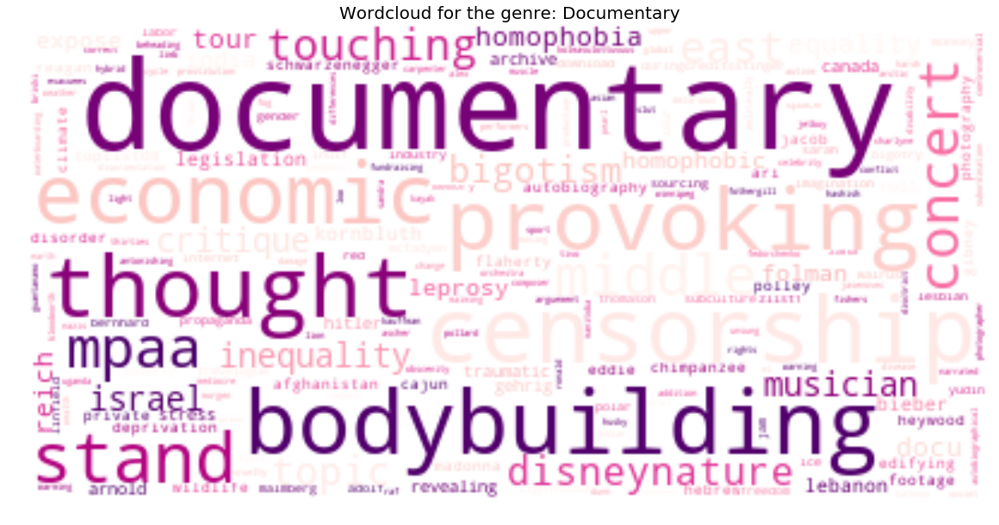

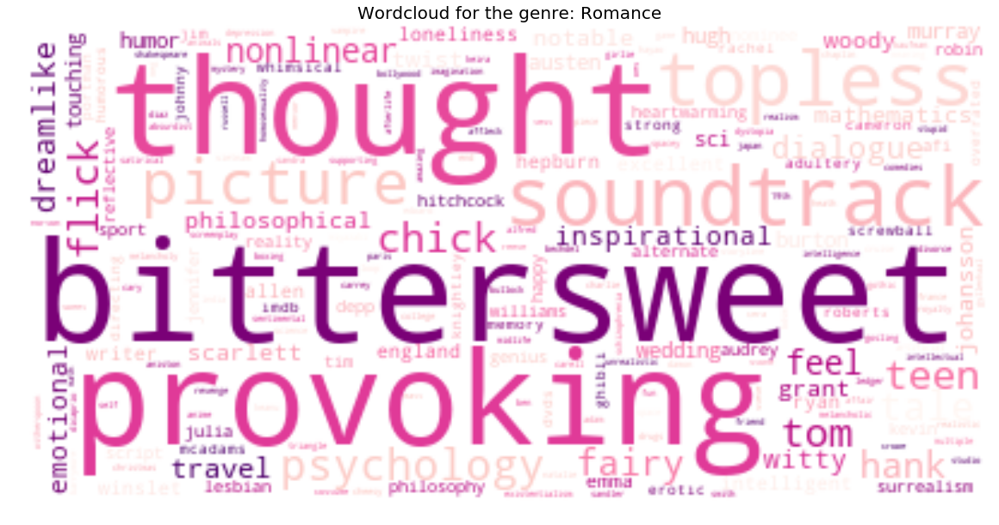

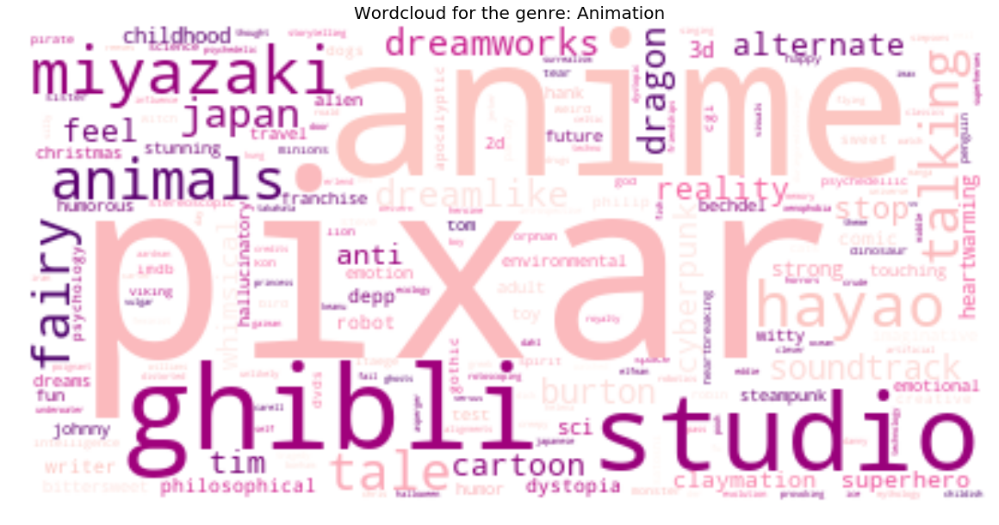

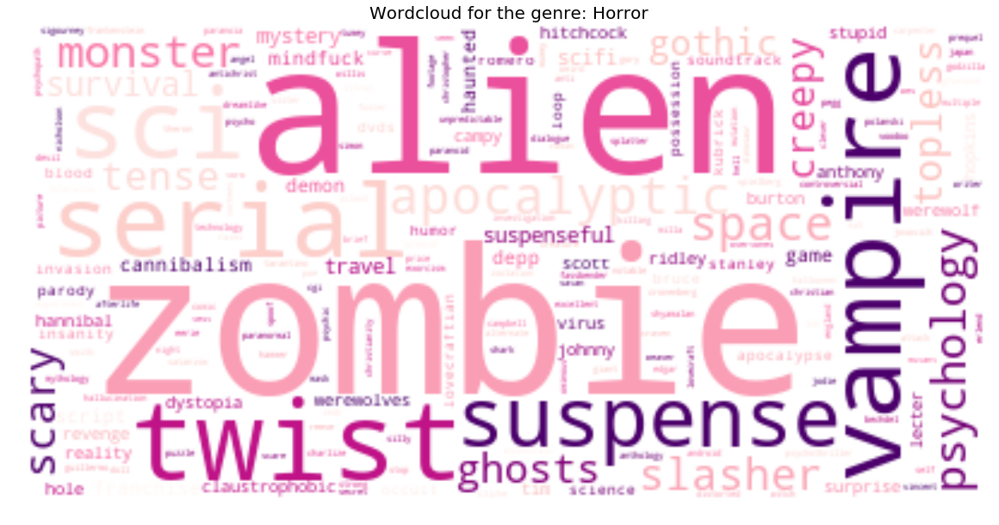

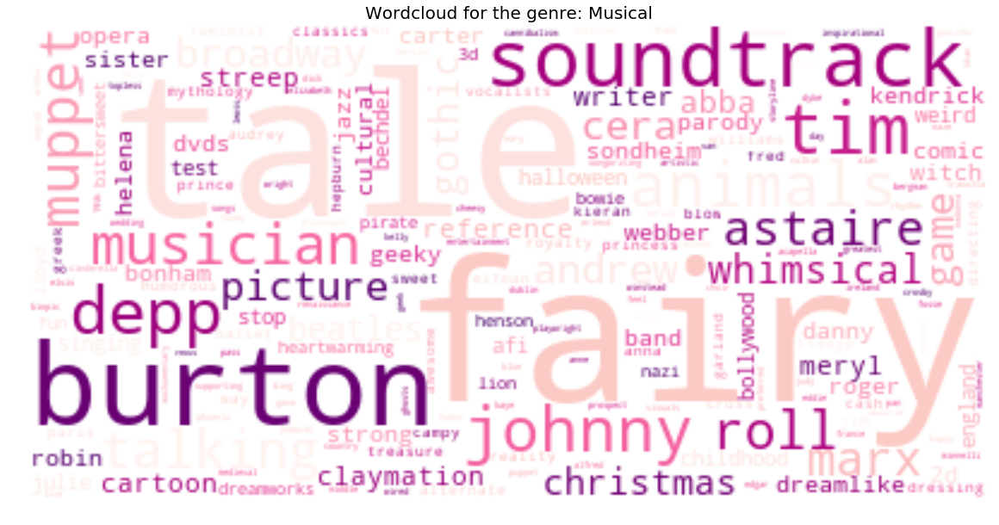

...

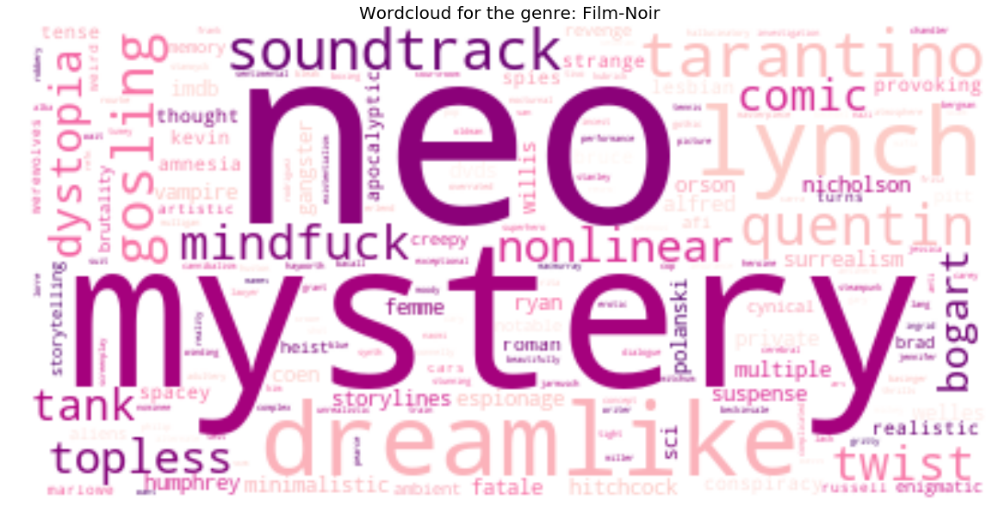

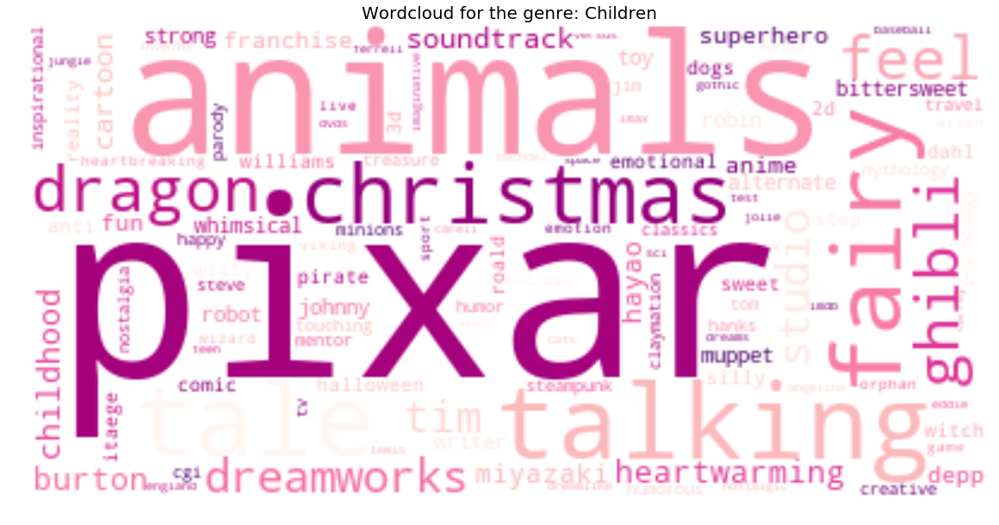

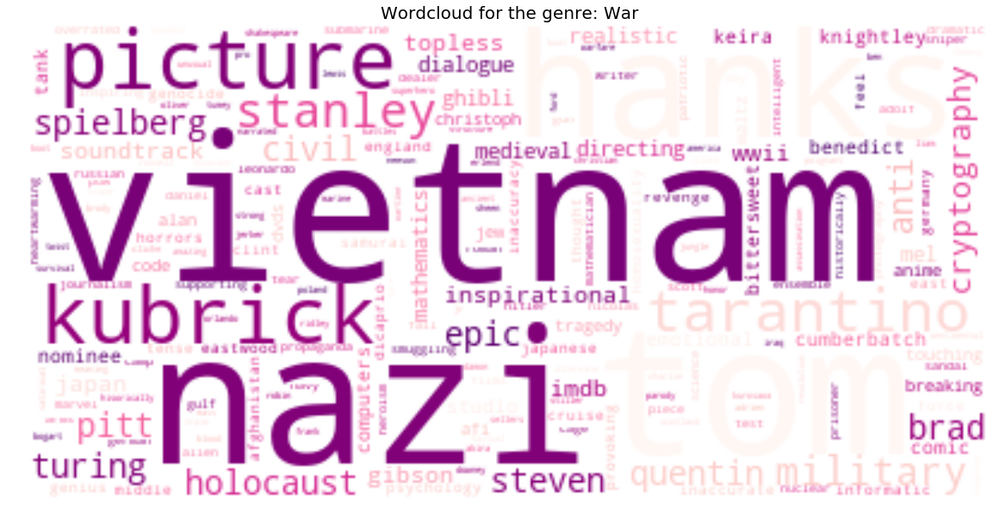

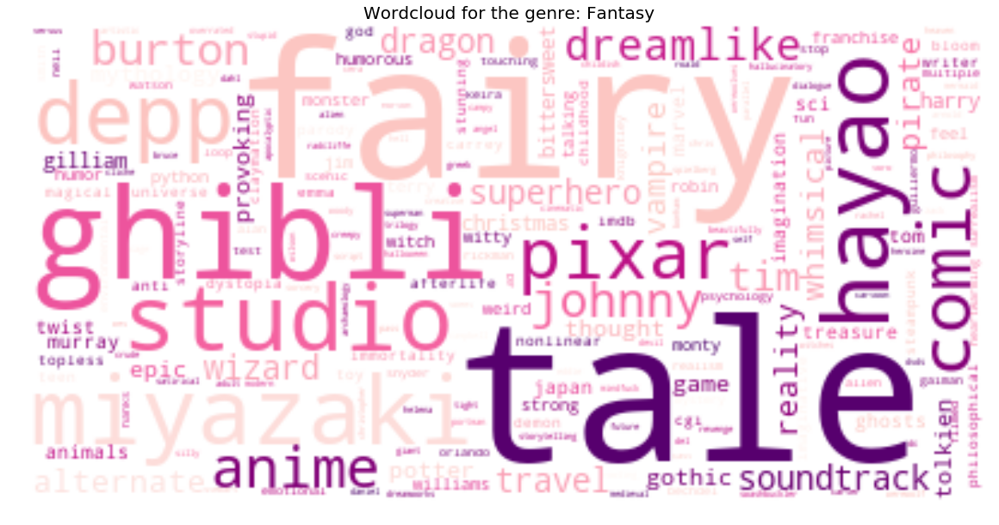

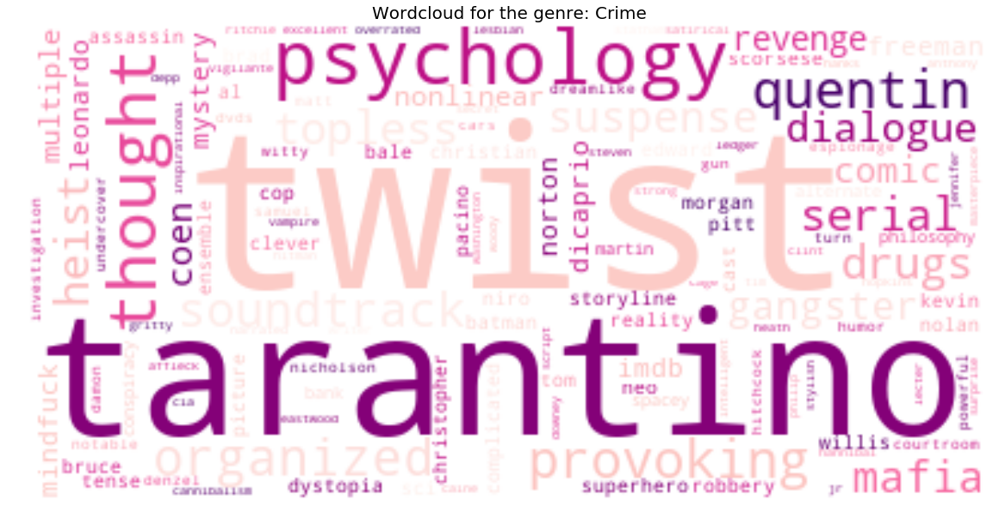

In [153]:
for genre in unique_genres:
    wordcloud = WordCloud(background_color="white", collocations=False,colormap='RdPu').generate(wc[genre])

    # Display the generated image:
    plt.figure(1,figsize=[20,20])
    plt.title('Wordcloud for the genre: ' + genre, size = 20)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [169]:
# Method for creating wordclouds when the corpus consists of two lists
def create_wordcloud_2(corpus):

    # Create a word count vector object
    cv = CountVectorizer(max_df=0.90, stop_words = 'english')
    word_count_vector = cv.fit_transform(corpus)
    
    # Create TF-IDF transform object
    tfidf_transform = TfidfTransformer(smooth_idf=True, use_idf=True)
    tfidf_transform.fit(word_count_vector)
    
    tfidf_values_negative = tfidf_transform.transform(cv.transform([corpus[0]]))
    tfidf_values_positive = tfidf_transform.transform(cv.transform([corpus[1]]))
    
    #Sorted TF-IDF values for the negative and positive
    sorted_tfidf_values_negative = sort_coo(tfidf_values_negative.tocoo())
    sorted_tfidf_values_positive = sort_coo(tfidf_values_positive.tocoo())
    
    feature_names = cv.get_feature_names()
    # Get keywords and their corresponding TF-IDF value
    keywords_negative = extract_from_vector(feature_names,sorted_tfidf_values_negative)
    keywords_positive = extract_from_vector(feature_names,sorted_tfidf_values_positive)
    
    # Scale the frequencies (i.e. the TF-IDF values) by a factor 100
    scaled_freq_negative = dict([(key,val*100) for key, val in keywords_negative.items()])
    scaled_freq_positive = dict([(key,val*100) for key, val in keywords_positive.items()])

    # Compute string of keywords. Each keyword is multiplied by its 'frequency'
    wc_negative = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_negative.items()])
    wc_positive = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_positive.items()])

    return [wc_negative, wc_positive]

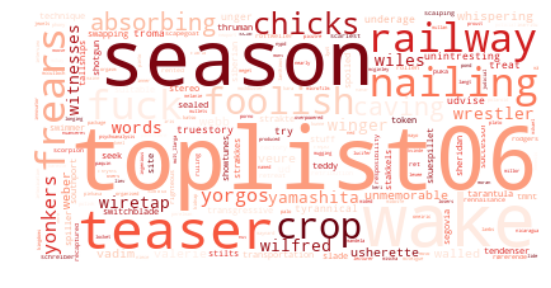

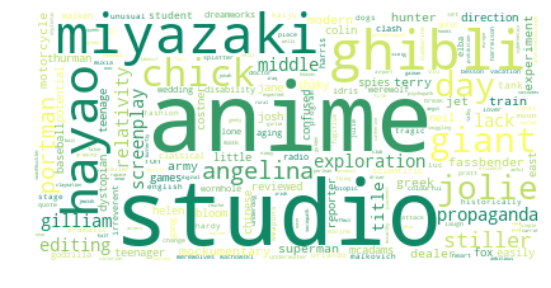

In [170]:
wordcloud_negative = WordCloud(background_color="white", collocations=False,colormap='Reds').generate(create_wordcloud_2(tag_neg_pos_corpus)[0])
wordcloud_positive = WordCloud(background_color="white", collocations=False,colormap='summer').generate(create_wordcloud_2(tag_neg_pos_corpus)[1])

plt.figure(1,figsize=[20,20])

plt.subplot(121)
plt.imshow(wordcloud_negative, interpolation='bilinear')
plt.axis("off")

plt.figure(2,figsize=[20,20])
plt.subplot(122)
plt.imshow(wordcloud_positive, interpolation='bilinear')
plt.axis("off")

plt.show()

In [166]:
negative_tags = []
positive_tags = []
tag_neg_pos_corpus = []

for genre in unique_genres:
    i = 0
    for sentiment in tag_sentiment_map[genre]:
        if sentiment < tag_means[genre] - 2* tag_std[genre]:
            negative_tags.append(tag_map[genre][i])
        elif sentiment > tag_means[genre] + 2* tag_std[genre]:
            positive_tags.append(tag_map[genre][i])
        i += 1
    
tag_neg_pos_corpus.append(' '.join(negative_tags))
tag_neg_pos_corpus.append(' '.join(positive_tags))

In [94]:
#del tag_neg_pos_corpus

In [132]:
# Create a word count vector object
cv_tags = CountVectorizer(max_df=0.90, stop_words = 'english')
#word_count_vector = {}

word_count_vector_tags = cv_tags.fit_transform(tag_neg_pos_corpus)

In [133]:
# Create TF-IDF transform object
tfidf_transform_tags = TfidfTransformer(smooth_idf=True, use_idf=True)
tfidf_transform_tags.fit(word_count_vector_tags)

TfidfTransformer(norm='l2', smooth_idf=True, sublinear_tf=False, use_idf=True)

In [139]:
tfidf_values_negative = tfidf_transform_tags.transform(cv_tags.transform([tag_neg_pos_corpus[0]]))
tfidf_values_positive = tfidf_transform_tags.transform(cv_tags.transform([tag_neg_pos_corpus[1]]))

In [140]:
sorted_tfidf_values_negative = sort_coo(tfidf_values_negative.tocoo())
sorted_tfidf_values_positive = sort_coo(tfidf_values_positive.tocoo())

In [141]:
feature_names = cv_tags.get_feature_names()
keywords_negative = extract_from_vector(feature_names,sorted_tfidf_values_negative)
keywords_positive = extract_from_vector(feature_names,sorted_tfidf_values_positive)

In [142]:
# Scale the frequencies (i.e. the TF-IDF values) by a factor 100
scaled_freq_negative = dict([(key,val*100) for key, val in keywords_negative.items()])
scaled_freq_positive = dict([(key,val*100) for key, val in keywords_positive.items()])

# Compute string of keywords. Each keyword is multiplied by its 'frequency'
wc_negative = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_negative.items()])
wc_positive = ' '.join([' '.join((f"{token}",) * math.ceil(val)) for token, val in scaled_freq_positive.items()])

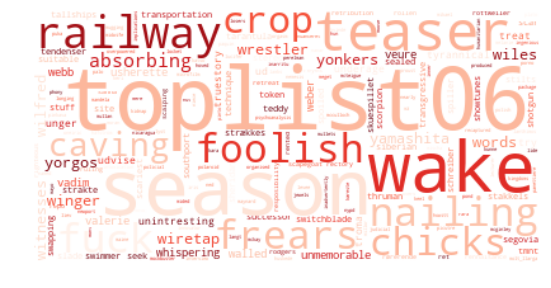

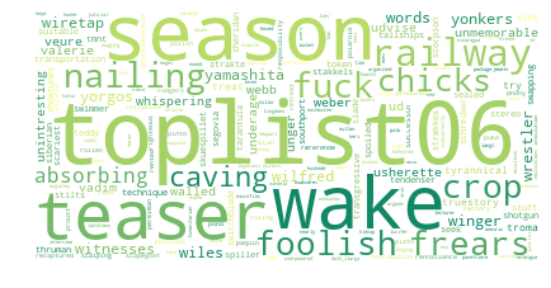

In [143]:
wordcloud_negative = WordCloud(background_color="white", collocations=False,colormap='Reds').generate(wc_negative)
wordcloud_positive = WordCloud(background_color="white", collocations=False,colormap='summer').generate(wc_negative)

plt.figure(1,figsize=[20,20])

plt.subplot(121)
plt.imshow(wordcloud_negative, interpolation='bilinear')
plt.axis("off")

plt.figure(2,figsize=[20,20])
plt.subplot(122)
plt.imshow(wordcloud_positive, interpolation='bilinear')
plt.axis("off")

plt.show()

In [ ]:
data = pd.read_csv('./Data_Set_S1.txt',sep='\t')
words = set(nltk.corpus.words.words())

# Fucntion for finding the sentiment for tokens 
def find_sentiment(tokens):
    
    # Initialization
    h_avg = []
    freq = []
    
    # Look for the token in the word list
    for token in tokens:
        if token in list(data['word']):
            # Find happines average and frequency of the token
            h_avg.append(data.loc[:,'happiness_average'].loc[data['word'] == token].iloc[0])
            freq.append(tokens.count(token))
            
    # Calculate the sentiment
    if len(h_avg) > 0:
        sentiment = np.dot(h_avg,freq) / sum(freq)
    # If there is no sentiment words in the tweet give it a neutral sentiment
    else:
        sentiment = None
            
    return sentiment